In [ ]:
import sys
sys.path
sys.path.append('/volatile/aurelien_stumpf_mascles/project/code/')

In [62]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import torch
import torch.nn as nn
import cebra_v2 as cebra2
from collections import defaultdict
import torch.nn.functional as F
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA,FastICA
from torch.utils.data.sampler import BatchSampler
import package
import pandas as pd
import matplotlib.animation as animation
import matplotlib.cm as cm
import tembedding
import scipy as sc
from skimage.metrics import structural_similarity as ssim
from sklearn.cluster import KMeans,OPTICS,DBSCAN
import math
from joblib import Memory,Parallel,delayed,parallel_backend
import time
from multiprocessing import Lock, Process, Queue
import multiprocessing
import queue 
import os
import networkx as nx
from scipy.spatial.transform import Rotation as R
import sklearn
import package.custom_clustering

In [46]:
import importlib
importlib.reload(package.preprocessing)
importlib.reload(cebra2.distribution)
importlib.reload(cebra2.dataset)

<module 'cebra_v2.dataset' from '/volatile/aurelien_stumpf_mascles/project/code/cebra_v2/dataset.py'>

## Présentation

Dans ce notebook, on essaye de classifier la condition deep-sevoflurane grâce à la méthode CEBRA.

## Fonctions utiles

In [2]:
def single_session_solver(data_loader, **kwargs):
    """Train a single session CEBRA model."""
    norm = True
    if kwargs['distance'] == 'euclidean':
        norm = False
    model = kwargs["model"]

    if kwargs['distance'] == 'euclidean':
        criterion = cebra2.criterion.EuclideanInfoNCE(temperature=kwargs['temperature'],beta = kwargs['beta'])
    elif kwargs['distance'] == 'cosine':        
        criterion = cebra2.criterion.CosineInfoNCE(temperature=kwargs['temperature'],beta = kwargs['beta'])

    optimizer = torch.optim.Adam(model.parameters(), lr=kwargs['learning_rate'])

    return cebra2.solver.SingleSessionSolver(model=model,
                                            criterion=criterion,
                                            optimizer=optimizer)

@torch.no_grad()
def get_emissions(model, dataset):
    if torch.cuda.is_available():
        device = "cuda"
    else:
        device = "cpu"
    model.to(device)
    return model(dataset).cpu().numpy()

def _compute_emissions_single(solver, dataset):
    return get_emissions(solver.model, dataset)

In [3]:
def generate_vector_distance_inter_zones(X,Y):
    a,b = X.shape
    c,d = Y.shape
    distance = np.zeros((a,c))
    for i in range(a):
        for j in range(c):
            distance[i,j] = np.linalg.norm(X[i,:] - Y[j,:])
    return distance

In [ ]:
def display(states,li_titles):
    
    # setting values to rows and column variables
    n = len(states)
    rows = n // 5 + 1
    columns = 5
    fig = plt.figure(figsize=(15, rows * 3))
    
    for i in range(n):
        fig.add_subplot(rows, columns, i+1)
        # showing image
        plt.imshow(states[i],cmap="hot")
        plt.axis('off')

## Data Loading

Dans le train, on garde les singes 'almira', 'khali', 'kimiko', 'rana'.
Dans le test, on utilise 'jade'.

In [5]:
dfc = np.load('/neurospin/lbi/monkeyfmri/deepstim/database/ANESTHETIC_database/derivatives/reference_kmeans/inputs/inputs.npy')
meta = pd.read_csv("/neurospin/lbi/monkeyfmri/deepstim/database/ANESTHETIC_database/derivatives/reference_kmeans/inputs/metadata.tsv", sep="\t")

In [6]:
n_runs = len(set(meta["unique_id"] + meta["monkey"]))
n_wins = 464
dfc_train = dfc[meta["monkey"].isin(['almira', 'khali', 'kimiko', 'rana'])].reshape((-1, n_wins, 82, 82))
dfc_test = dfc[meta["monkey"] == "jade"].reshape((-1, n_wins, 82, 82))
dfc_all = dfc.reshape((-1, n_wins, 82, 82))

In [7]:
meta["condition"][55*464:]

25520            ketamine
25521            ketamine
25522            ketamine
25523            ketamine
25524            ketamine
               ...       
72379    deep-sevoflurane
72380    deep-sevoflurane
72381    deep-sevoflurane
72382    deep-sevoflurane
72383    deep-sevoflurane
Name: condition, Length: 46864, dtype: object

## Animation

Saved at /volatile/aurelien_stumpf_mascles/project/code/visuals/animation/movie150.mp4


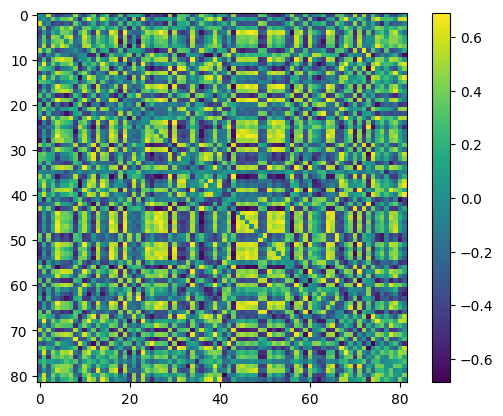

In [27]:
import matplotlib.animation as animation

# ims is a list of lists, each row is a list of artists to draw in the
# current frame; here we are just animating one artist, the image, in
# each frame
for a in [150] :
    ims = []
    fig, ax = plt.subplots()
    for i in range(464):
        im = ax.imshow(dfc[a,i,:,:], animated=True)
        if i == 0:
            ax.imshow(dfc[a,i,:,:])  # show an initial one first
        ims.append([im])

    ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True,
                                    repeat_delay=1000)
    
    fig.colorbar(im, ax=ax)
    
    ani.save("/volatile/aurelien_stumpf_mascles/project/code/visuals/animation/movie{}.mp4".format(a))
    print("Saved at /volatile/aurelien_stumpf_mascles/project/code/visuals/animation/movie{}.mp4".format(a))

# To save the animation, use e.g.
#
# ani.save("movie.mp4")
#
# or
#
# writer = animation.FFMpegWriter(
#     fps=15, metadata=dict(artist='Me'), bitrate=1800)
# ani.save("movie.mp4", writer=writer)

plt.show()

## OPTICS ON RAW DATA

In [7]:
def STRUCTURE(x,y):
        return 1 - package.preprocessing.structure(x,y,is_batch = False)

distance = np.load("./DistanceMatrices/light_propofol/distance_matrix_6_sessions_structure.npy")

def STRUCTURE2(idx,idy):
        return distance[idx[0],idx[1],idy[0],idy[1]]

metric = STRUCTURE2

In [8]:
dfc_train_light_propofol = dfc[(meta["monkey"].isin(['almira', 'khali', 'kimiko', 'rana'])) & (meta["condition"] == "light-propofol")].reshape(-1,n_wins,82,82)
fc_train = dfc_train_light_propofol[0:6,:,:,:].reshape((6*464,1,82,82))
X = distance.reshape((6*464,6*464))

For n_clusters = 66 The average silhouette_score is : 0.18242839571222788


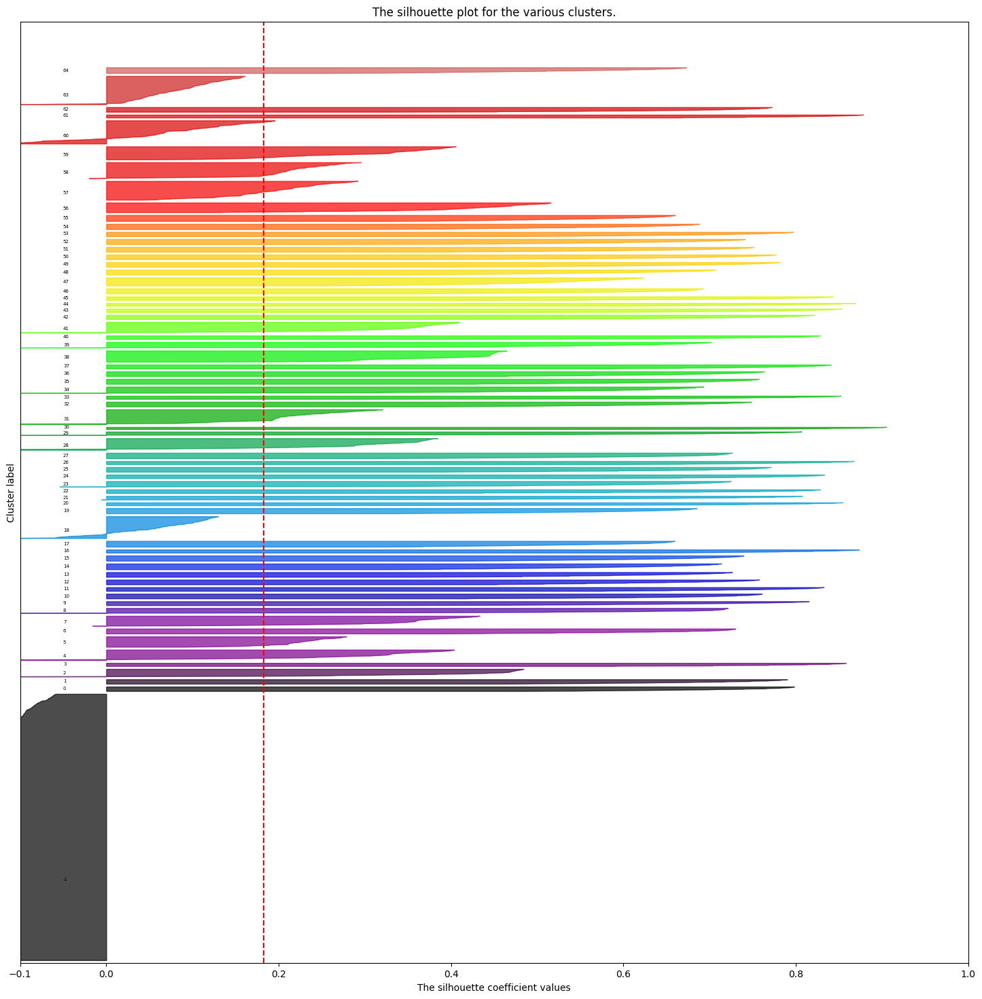

In [41]:
# Create a subplot with 1 row and 2 columns
fig, ax1 = plt.subplots(1, 1)
fig.set_size_inches(18, 18)

# Initialize the clusterer with n_clusters value and a random generator
# seed of 10 for reproducibility.
clustering = DBSCAN(eps=0.2, min_samples=12, metric="precomputed").fit(X)
#clustering = OPTICS(min_samples=5, min_cluster_size = 10, metric="precomputed").fit(X)
cluster_labels = clustering.labels_
n_clusters = len(np.unique(cluster_labels))

# The silhouette_score gives the average value for all the samples.
# This gives a perspective into the density and separation of the formed
# clusters
silhouette_avg = sklearn.metrics.silhouette_score(X, cluster_labels, metric = "precomputed")
print(
    "For n_clusters =",
    n_clusters,
    "The average silhouette_score is :",
    silhouette_avg,
)

# Compute the silhouette scores for each sample
sample_silhouette_values = sklearn.metrics.silhouette_samples(X, cluster_labels, metric = "precomputed")

# The 1st subplot is the silhouette plot
# The silhouette coefficient can range from -1, 1 but in this example all
# lie within [-0.1, 1]
ax1.set_xlim([-0.1, 1])
# The (n_clusters+1)*10 is for inserting blank space between silhouette
# plots of individual clusters, to demarcate them clearly.
ax1.set_ylim([0, 1.3*len(X)])

y_lower = 10
for i in range(-1,n_clusters-1):
    # Aggregate the silhouette scores for samples belonging to
    # cluster i, and sort them
    ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

    ith_cluster_silhouette_values.sort()

    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    color = cm.nipy_spectral(float(i) / n_clusters)
    ax1.fill_betweenx(
        np.arange(y_lower, y_upper),
        0,
        ith_cluster_silhouette_values,
        facecolor=color,
        edgecolor=color,
        alpha=0.7,
    )

    # Label the silhouette plots with their cluster numbers at the middle
    ax1.text(-0.05, y_lower + 0.3 * size_cluster_i, str(i), fontsize=5)

    # Compute the new y_lower for next plot
    y_lower = y_upper + 10  # 10 for the 0 samples

ax1.set_title("The silhouette plot for the various clusters.")
ax1.set_xlabel("The silhouette coefficient values")
ax1.set_ylabel("Cluster label")

# The vertical line for average silhouette score of all the values
ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

ax1.set_yticks([])  # Clear the yaxis labels / ticks
ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

(array([1025.,   18.,   18.,   30.,   13.,   41.,   41.,   20.,   39.,
          20.,   16.,   19.,   15.,   19.,   19.,   23.,   21.,   13.,
          23.,   85.,   21.,   12.,   15.,   15.,   22.,   15.,   19.,
          13.,   22.,   46.,   14.,    9.,   58.,   19.,   13.,   25.,
          20.,   19.,   16.,   44.,   23.,   15.,   42.,   17.,   14.,
          12.,   15.,   21.,   32.,   20.,   19.,   19.,   19.,   21.,
          17.,   21.,   24.,   38.,   73.,   62.,   51.,   90.,   12.,
          19.,  110.,   23.]),
 array([-1.00000000e+00, -1.51515152e-02,  9.69696970e-01,  1.95454545e+00,
         2.93939394e+00,  3.92424242e+00,  4.90909091e+00,  5.89393939e+00,
         6.87878788e+00,  7.86363636e+00,  8.84848485e+00,  9.83333333e+00,
         1.08181818e+01,  1.18030303e+01,  1.27878788e+01,  1.37727273e+01,
         1.47575758e+01,  1.57424242e+01,  1.67272727e+01,  1.77121212e+01,
         1.86969697e+01,  1.96818182e+01,  2.06666667e+01,  2.16515152e+01,
         2.26363

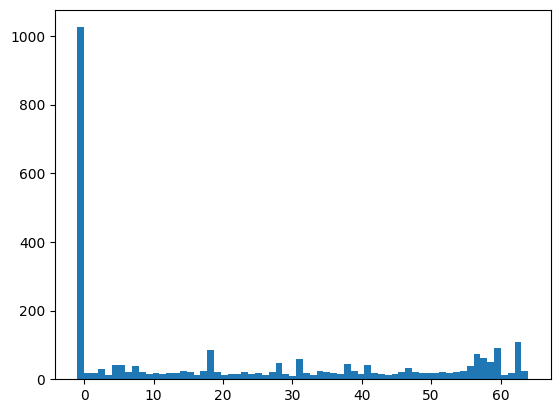

In [42]:
plt.hist(clustering.labels_,bins = len(np.unique(clustering.labels_)))

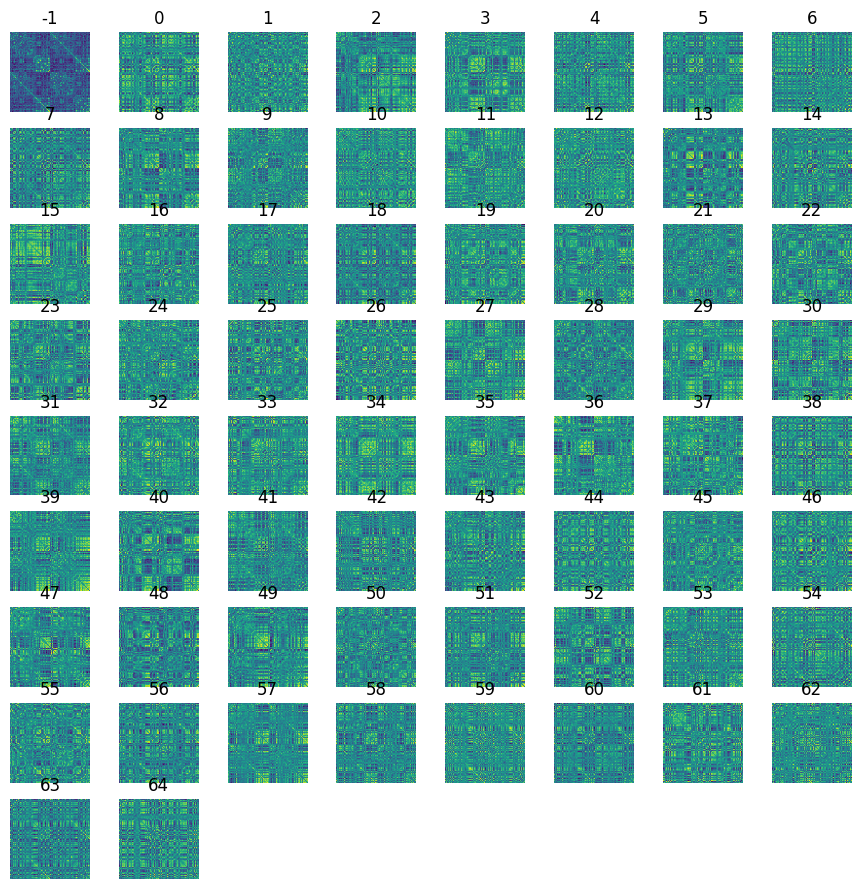

In [43]:
list_label = clustering.labels_
data_mat = fc_train.reshape(6*464,82,82)
mean_states = np.array([np.mean(data_mat[list_label == i],axis=0) for i in np.unique(clustering.labels_)])
accu = torch.from_numpy(package.preprocessing.flatten_higher_triangular(torch.from_numpy(mean_states.reshape(1,len(np.unique(clustering.labels_)),82,82)))).type(torch.float32)
display(mean_states,np.unique(clustering.labels_))

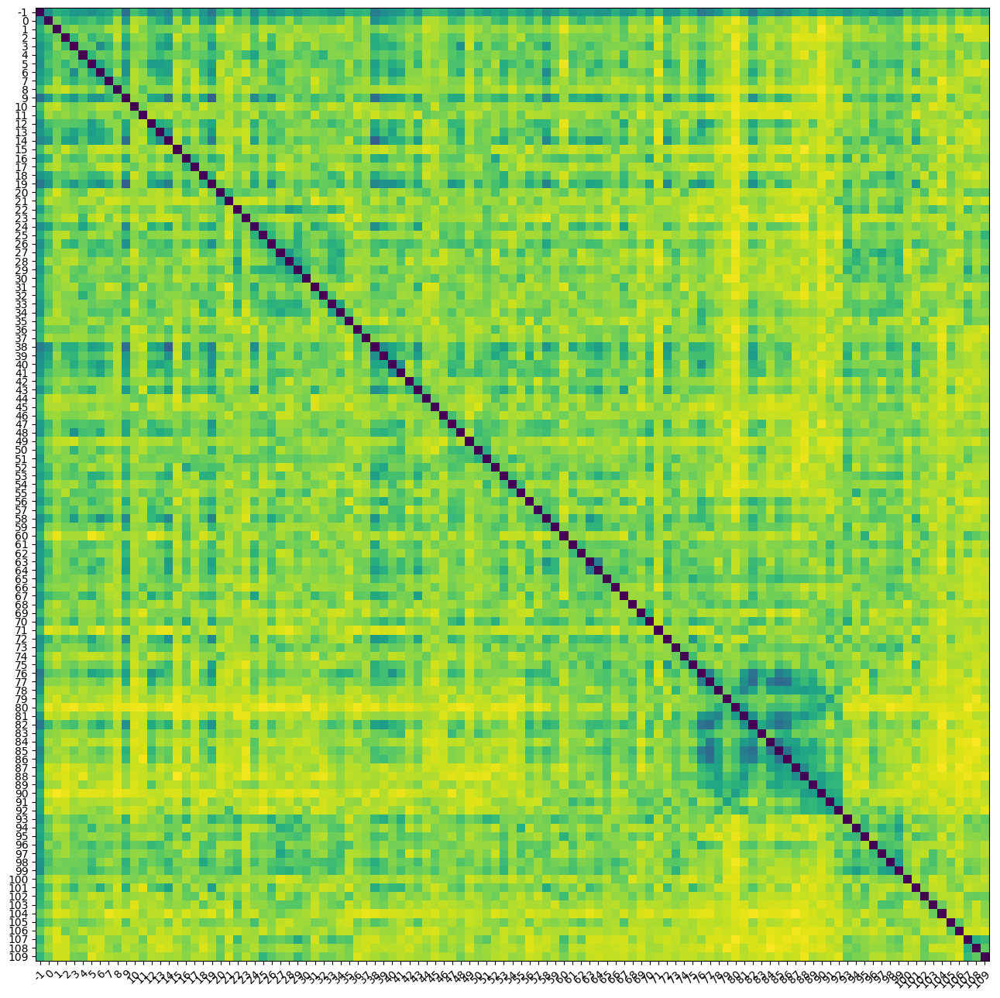

In [16]:
mat = np.zeros((len(mean_states),len(mean_states)))
for i in range(len(mean_states)):
    for j in range(i+1, len(mean_states)):
        accu = STRUCTURE(torch.from_numpy(mean_states[i,:,:]),torch.from_numpy(mean_states[j,:,:])).item()
        mat[i,j] = accu
        mat[j,i] = accu
        
fig, ax = plt.subplots(figsize = (13,13))
im = ax.imshow(mat,extent = (-1.5, len(mat) - 1.5, len(mat) - 1.5, -1.5))

# Show all ticks and label them with the respective list entries
ax.set_xticks(np.arange(-1,len(mat)-1), labels=np.arange(-1,len(mat)-1))
ax.set_yticks(np.arange(-1,len(mat)-1), labels=np.arange(-1,len(mat)-1))

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
         rotation_mode="anchor")

"""
# Loop over data dimensions and create text annotations.
for i in range(-1,len(mat)-1):
    for j in range(-1,len(mat)-1):
        text = ax.text(j, i, np.around(mat[i+1, j+1],decimals=1),
                       ha="center", va="center", color="w")
"""

fig.tight_layout()
plt.show()

## Other Clustering Method

In [61]:
import importlib
importlib.reload(package.custom_clustering)

<module 'package.custom_clustering' from '/volatile/aurelien_stumpf_mascles/project/code/package/custom_clustering.py'>

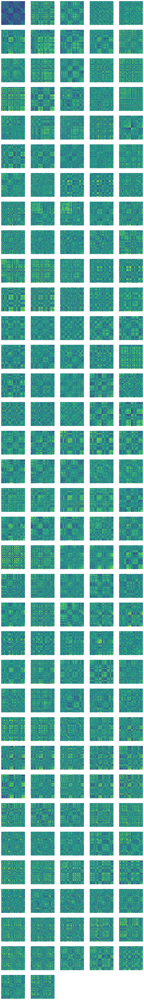

In [84]:
labels = package.custom_clustering.BallClustering(distance = X, epsilon = 0.3, min_samples = 15)
list_label = labels
data_mat = fc_train.reshape(6*464,82,82)
mean_states = np.array([np.mean(data_mat[list_label == i],axis=0) for i in np.unique(labels)])
accu = torch.from_numpy(package.preprocessing.flatten_higher_triangular(torch.from_numpy(mean_states.reshape(1,len(np.unique(labels)),82,82)))).type(torch.float32)
display(mean_states,np.unique(labels))

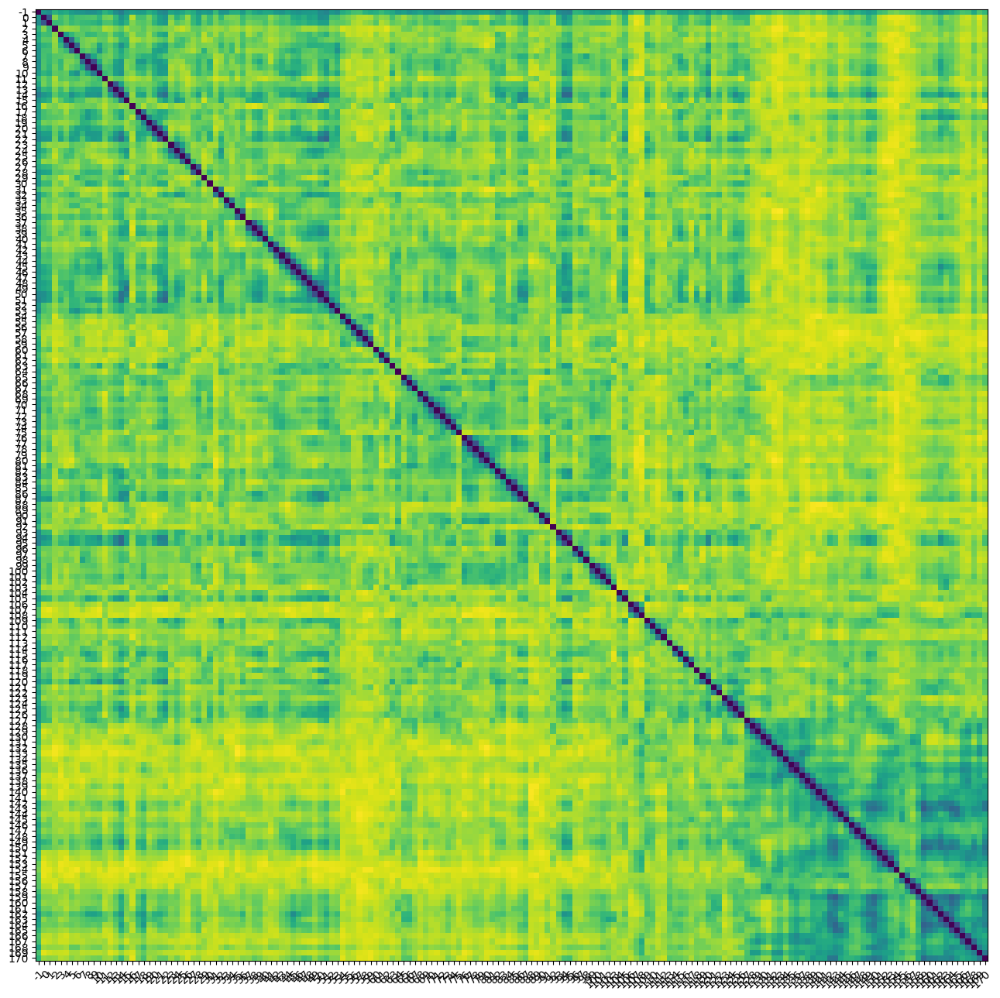

In [85]:
mat = np.zeros((len(mean_states),len(mean_states)))
for i in range(len(mean_states)):
    for j in range(i+1, len(mean_states)):
        accu = STRUCTURE(torch.from_numpy(mean_states[i,:,:]),torch.from_numpy(mean_states[j,:,:])).item()
        mat[i,j] = accu
        mat[j,i] = accu
        
fig, ax = plt.subplots(figsize = (13,13))
im = ax.imshow(mat,extent = (-1.5, len(mat) - 1.5, len(mat) - 1.5, -1.5))

# Show all ticks and label them with the respective list entries
ax.set_xticks(np.arange(-1,len(mat)-1), labels=np.arange(-1,len(mat)-1))
ax.set_yticks(np.arange(-1,len(mat)-1), labels=np.arange(-1,len(mat)-1))

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
         rotation_mode="anchor")

"""
# Loop over data dimensions and create text annotations.
for i in range(-1,len(mat)-1):
    for j in range(-1,len(mat)-1):
        text = ax.text(j, i, np.around(mat[i+1, j+1],decimals=1),
                       ha="center", va="center", color="w")
"""

fig.tight_layout()
plt.show()

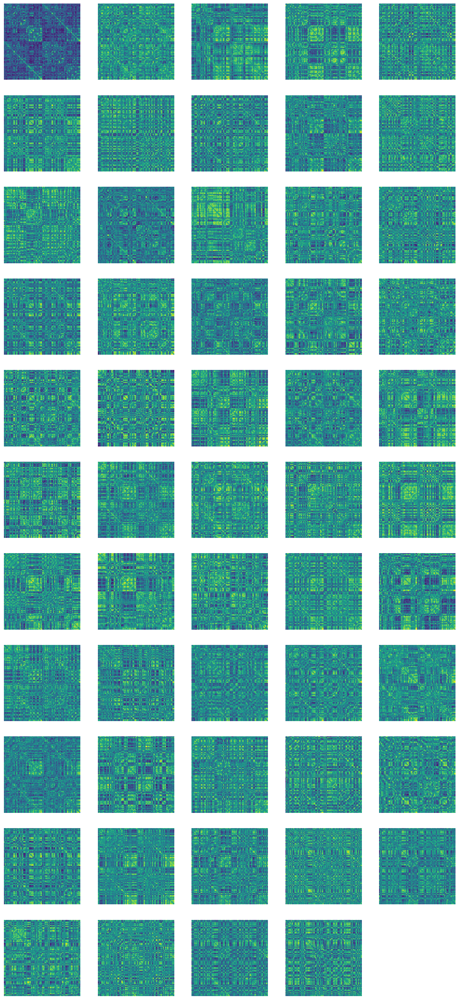

In [90]:
dict_categories_to_labels = {}
cluster_num = 1
for i in range(1,len(mat)):
    flag = False
    for key,li in dict_categories_to_labels.items():
        for idx in li :
            if mat[i,idx+1] < 0.3 :
                dict_categories_to_labels[key].append(i-1)
                flag = True
                break
        if flag : 
            break
    if not flag : 
        dict_categories_to_labels[cluster_num] = [i-1]
        cluster_num += 1

dict_labels_to_categories = {}
for k,li in dict_categories_to_labels.items():
    for elem in li:
        dict_labels_to_categories[elem] = k
dict_labels_to_categories[-1] = -1

list_label = np.array([dict_labels_to_categories[x] for x in cluster_labels])
data_mat = fc_train.reshape(6*464,82,82)
mean_states = np.array([np.mean(data_mat[list_label == i],axis=0) for i in np.sort(np.unique(list_label))])
accu = torch.from_numpy(package.preprocessing.flatten_higher_triangular(torch.from_numpy(mean_states.reshape(1,len(np.unique(list_label)),82,82)))).type(torch.float32)
display(mean_states,np.unique(list_label))

In [92]:
np.save(file = "./BrainStates/light-propofol/mean_states.npy",arr = mean_states)

: 